## Visualization of CNN: Grad-CAM
* **Objective**: Convolutional Neural Networks are widely used on computer vision. It is powerful for processing grid-like data. However we hardly know how and why it works, due to the lack of decomposability into individually intuitive components. In this assignment, we use Grad-CAM, which highlights the regions of the input image that were important for the neural network prediction.



* NB: if `PIL` is not installed, try `conda install pillow`.


In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models, datasets, transforms
import matplotlib.pyplot as plt
import pickle
import urllib.request

import numpy as np
from PIL import Image

%matplotlib inline

### Download the Model
We provide you a pretrained model `ResNet-34` for `ImageNet` classification dataset.
* **ImageNet**: A large dataset of photographs with 1 000 classes.
* **ResNet-34**: A deep architecture for image classification.

In [2]:
resnet34 = models.resnet34(pretrained=True)
resnet34.eval() # set the model to evaluation mode

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:02<00:00, 37.1MB/s]


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

![ResNet34](https://miro.medium.com/max/1050/1*Y-u7dH4WC-dXyn9jOG4w0w.png)

In [3]:
classes = pickle.load(urllib.request.urlopen('https://gist.githubusercontent.com/yrevar/6135f1bd8dcf2e0cc683/raw/d133d61a09d7e5a3b36b8c111a8dd5c4b5d560ee/imagenet1000_clsid_to_human.pkl') )

### Input Images
We provide you 20 images from ImageNet (download link on the webpage of the course or download directly using the following command line,).<br>
In order to use the pretrained model resnet34, the input image should be normalized using `mean = [0.485, 0.456, 0.406]`, and `std = [0.229, 0.224, 0.225]`, and be resized as `(224, 224)`.

In [9]:
def preprocess_image(dir_path):
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])

    dataset = datasets.ImageFolder(dir_path, transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224), # resize the image to 224x224
            transforms.ToTensor(), # convert numpy.array to tensor
            normalize])) #normalize the tensor

    return (dataset)

In [10]:
# The images should be in a *sub*-folder of "data/" (ex: data/TP2_images/images.jpg) and *not* directly in "data/"!
# otherwise the function won't find them

import os
os.mkdir("data")
os.mkdir("data/TP2_images")
!cd data/TP2_images && wget "https://www.lri.fr/~gcharpia/deeppractice/2022/TP2/TP2_images.zip" && unzip TP2_images.zip
dir_path = "data/"
dataset = preprocess_image(dir_path)

--2024-08-20 21:40:34--  https://www.lri.fr/~gcharpia/deeppractice/2022/TP2/TP2_images.zip
Resolving www.lri.fr (www.lri.fr)... 129.175.15.11
Connecting to www.lri.fr (www.lri.fr)|129.175.15.11|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1477062 (1.4M) [application/zip]
Saving to: ‘TP2_images.zip’

TP2_images.zip      100%[===================>]   1.41M  1.48MB/s    in 1.0s    

2024-08-20 21:40:37 (1.48 MB/s) - ‘TP2_images.zip’ saved [1477062/1477062]

Archive:  TP2_images.zip
   creating: .ipynb_checkpoints/
  inflating: 155881293_721e90b57d.jpg  
  inflating: 158850087_3251644046.jpg  
  inflating: 1624593475_146bf1f7ff.jpg  
  inflating: 181748579_01a4611736.jpg  
  inflating: 2068921624_ef0986de13.jpg  
  inflating: 2637374064_fab14ec0b8.jpg  
  inflating: 2749465889_8e62023674.jpg  
  inflating: 2936812850_23bf0d1cfd.jpg  
  inflating: 3532471222_a6d7e3780e.jpg  
  inflating: 3633913271_ee789a3bc4.jpg  
  inflating: 3633949157_f577605ea9.jpg  
  infla

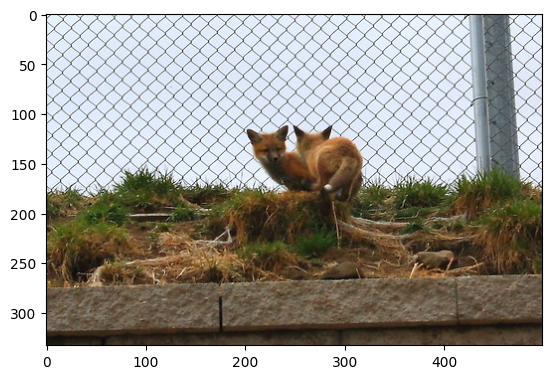

In [11]:
# show the orignal image
index = 11
input_image = Image.open(dataset.imgs[index][0]).convert('RGB')
plt.imshow(input_image)

In [12]:
output = resnet34(dataset[index][0].view(1, 3, 224, 224))
values, indices = torch.topk(output, 3)
print("Top 3-classes:", indices[0].numpy(), [classes[x] for x in indices[0].numpy()])
print("Raw class scores:", values[0].detach().numpy())

Top 3-classes: [271 278 277] ['red wolf, maned wolf, Canis rufus, Canis niger', 'kit fox, Vulpes macrotis', 'red fox, Vulpes vulpes']
Raw class scores: [16.088785 15.048848 14.798764]


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py:1373: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


### Grad-CAM
* **Overview:** Given an image, and a category (‘tiger cat’) as input, we forward-propagate the image through the model to obtain the `raw class scores` before softmax. The gradients are set to zero for all classes except the desired class (tiger cat), which is set to 1. This signal is then backpropagated to the `rectified convolutional feature map` of interest, where we can compute the coarse Grad-CAM localization (blue heatmap).


* **To Do**: Define your own function Grad_CAM to achieve the visualization of the given images. For each image, choose the top-3 possible labels as the desired classes. Compare the heatmaps of the three classes, and conclude.


* **Hints**:
 + We need to record the output and grad_output of the feature maps to achieve Grad-CAM. In pytorch, the function `Hook` is defined for this purpose. Read the tutorial of [hook](https://pytorch.org/tutorials/beginner/former_torchies/nnft_tutorial.html#forward-and-backward-function-hooks) carefully.
 + The pretrained model resnet34 doesn't have an activation function after its last layer, the output is indeed the `raw class scores`, you can use them directly.
 + The size of feature maps is 7x7, so your heatmap will have the same size. You need to project the heatmap to the resized image (224x224, not the original one, before the normalization) to have a better observation. The function [`torch.nn.functional.interpolate`](https://pytorch.org/docs/stable/nn.functional.html?highlight=interpolate#torch.nn.functional.interpolate) may help.  
 + Here is the link of the paper [Grad-CAM: Visual Explanations from Deep Networks via Gradient-based Localization](https://arxiv.org/pdf/1610.02391.pdf)

![Grad-CAM](https://da2so.github.io/assets/post_img/2020-08-10-GradCAM/2.png)

In [13]:
class GradCam:
    """ Grad Camp wrapper for a network """
    def __init__(self,model):
        self.pointer = [None]
        self.put_hook(model)
    def put_hook(self,model):
        """ Sets the network of this wrapper """
        self.model = model
        pointer = self.pointer
        #Define forward hook
        def get_activation(self,input,output):
            pointer[0] = output
        #Define backward hook
        def get_grad(self,input,output):
            grad = input[0]
            alpha = grad.mean(axis=3).mean(axis=2)
            activation = pointer[0]
            merge = nn.functional.relu((alpha[...,None,None]*activation).mean(axis=1))
            visu = torch.nn.functional.interpolate(merge[None],size=224,mode='bicubic')[0]
            pointer[0] = visu
        #Put hooks
        model.layer4.register_forward_hook(get_activation)
        model.layer4.register_backward_hook(get_grad)
    def forward(self,img,label):
        """ Forwards the gradcam pipeline on given batch """
        pred = self.model(img)[0]
        pred_classes = pred[label]
        pred_classes.backward()
        return self.pointer[0]
    def __call__(self,*args):
        return self.forward(*args)

In [14]:
%%capture
resnet34 = models.resnet34(pretrained=True)
resnet34.eval() # set the model to evaluation mode

In [15]:
gc = GradCam(resnet34)

In [16]:
nb_img = 20
nb_masks = 3

In [17]:
#Compute masks
masks = torch.zeros(size=(nb_img,nb_masks,224,224))
labels = torch.zeros(size=(nb_img,nb_masks))
scores = torch.zeros(size=(nb_img,nb_masks))
probs = torch.zeros(size=(nb_img,nb_masks))
for i in range(nb_img):
    img = dataset[i][0].view(1,3,224,224)
    preds = resnet34(img)
    predsk,best_preds = torch.topk(preds, nb_masks)
    labels[i] = best_preds[0]
    scores[i] = predsk[0]
    prob = torch.nn.Softmax(dim=1)(preds)
    probs[i],_ = torch.topk(prob,nb_masks)
    for j,lbl in enumerate(best_preds[0]):
        masks[i,j] = gc(img,int(lbl))
        masks[i,j] = masks[i,j]#/masks[i,j].max()

In [18]:
#Plot function
def plot_masked(idx):
    fig = plt.figure(figsize=(20,20))
    plt.subplot(1,nb_masks+1,1)
    pil_img = transforms.CenterCrop(224)(Image.open(dataset.imgs[i][0]))
    plt.imshow(pil_img)
    print(idx,"-"*100)
    for j,k in enumerate(labels[i]):
        print("class : ",classes[int(k.numpy())],"| score : ",scores[i][j].detach().numpy(),"| probability : ",probs[i][j].detach().numpy())
    for j in range(masks[i].shape[0]):
        plt.subplot(1,nb_masks+1,j+2)
        masks[i,j]/=masks[i,j].max()
        colored_mask = torch.tensor(plt.cm.jet(masks[i,j].numpy())[...])
        colored_mask[...,3] = colored_mask.mean(dim=-1)
        plt.imshow(pil_img)
        plt.imshow(colored_mask)
    plt.show()

0 ----------------------------------------------------------------------------------------------------
class :  African elephant, Loxodonta africana | score :  19.809284 | probability :  0.766189
class :  Indian elephant, Elephas maximus | score :  18.44351 | probability :  0.19551843
class :  tusker | score :  16.811417 | probability :  0.038227733


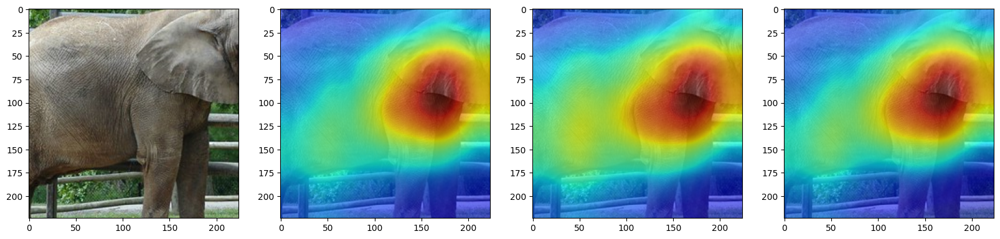

1 ----------------------------------------------------------------------------------------------------
class :  porcupine, hedgehog | score :  11.450407 | probability :  0.73124814
class :  marmoset | score :  9.795343 | probability :  0.13972682
class :  sloth bear, Melursus ursinus, Ursus ursinus | score :  7.4540315 | probability :  0.013441908


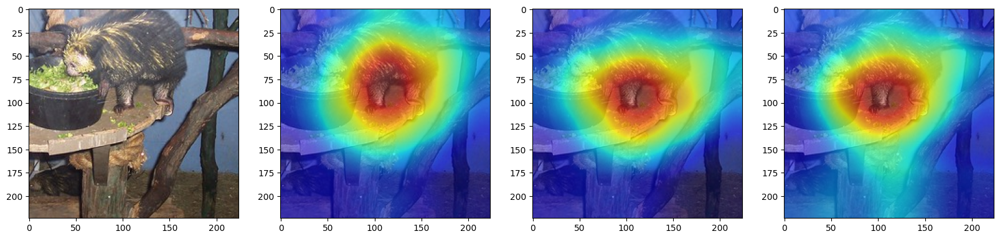

2 ----------------------------------------------------------------------------------------------------
class :  Tibetan terrier, chrysanthemum dog | score :  10.158126 | probability :  0.38191414
class :  Old English sheepdog, bobtail | score :  8.521873 | probability :  0.074361876
class :  Border collie | score :  8.450981 | probability :  0.06927271


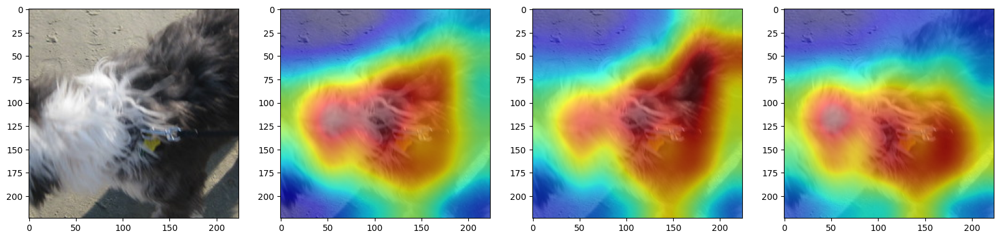

3 ----------------------------------------------------------------------------------------------------
class :  Norwegian elkhound, elkhound | score :  12.780791 | probability :  0.4194778
class :  Cardigan, Cardigan Welsh corgi | score :  11.761657 | probability :  0.15139253
class :  German shepherd, German shepherd dog, German police dog, alsatian | score :  11.681355 | probability :  0.13971083


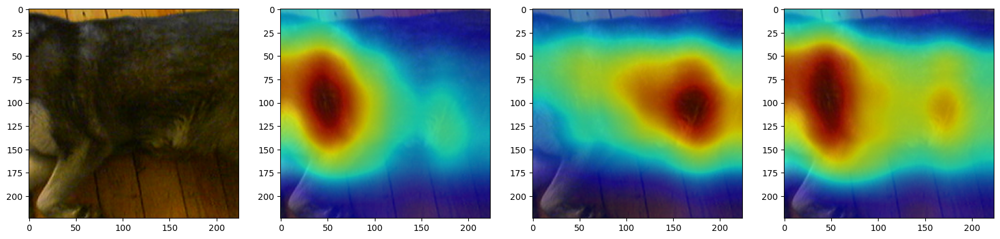

4 ----------------------------------------------------------------------------------------------------
class :  English springer, English springer spaniel | score :  18.346344 | probability :  0.9072918
class :  Sussex spaniel | score :  15.0718975 | probability :  0.034329932
class :  Welsh springer spaniel | score :  15.043118 | probability :  0.033356


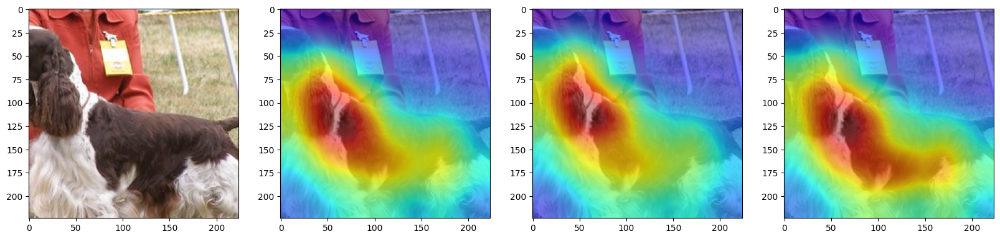

5 ----------------------------------------------------------------------------------------------------
class :  Egyptian cat | score :  13.175315 | probability :  0.82494885
class :  tabby, tabby cat | score :  11.065538 | probability :  0.10003748
class :  tiger cat | score :  10.584751 | probability :  0.061852813


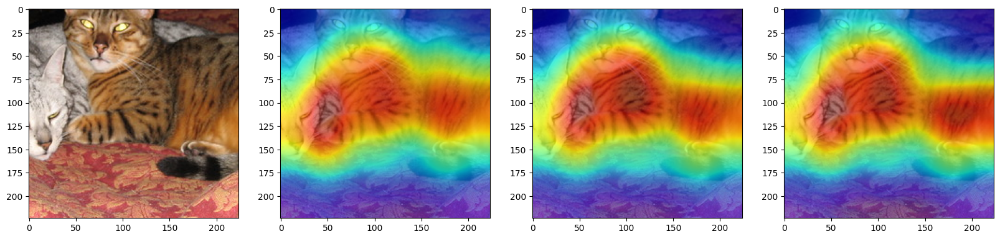

6 ----------------------------------------------------------------------------------------------------
class :  Arctic fox, white fox, Alopex lagopus | score :  13.450595 | probability :  0.6730168
class :  kit fox, Vulpes macrotis | score :  12.364035 | probability :  0.22705902
class :  grey fox, gray fox, Urocyon cinereoargenteus | score :  10.374113 | probability :  0.031040363


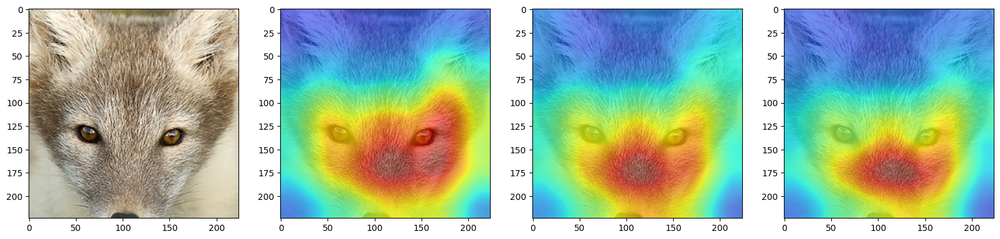

7 ----------------------------------------------------------------------------------------------------
class :  Great Dane | score :  9.138786 | probability :  0.30252177
class :  Labrador retriever | score :  8.560343 | probability :  0.16964528
class :  Chesapeake Bay retriever | score :  7.8655367 | probability :  0.08468205


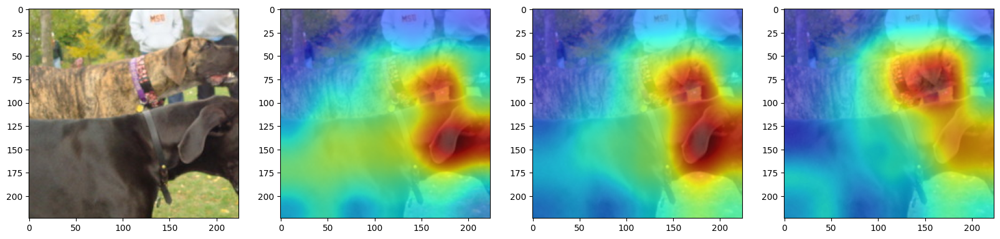

8 ----------------------------------------------------------------------------------------------------
class :  weasel | score :  14.059566 | probability :  0.5045516
class :  mink | score :  13.711961 | probability :  0.35640413
class :  otter | score :  12.581789 | probability :  0.11511061


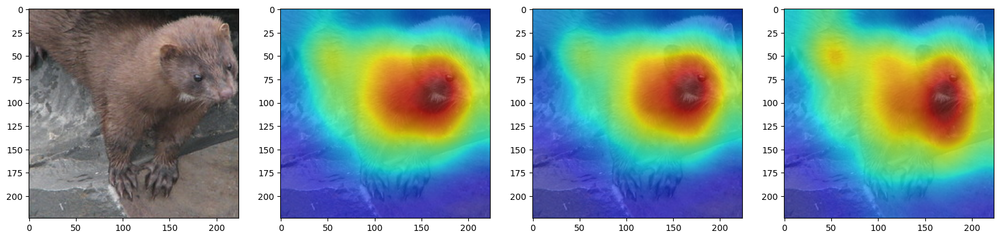

9 ----------------------------------------------------------------------------------------------------
class :  ibex, Capra ibex | score :  19.991968 | probability :  0.9961266
class :  bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis | score :  13.663734 | probability :  0.0017782694
class :  ram, tup | score :  13.241569 | probability :  0.0011658784


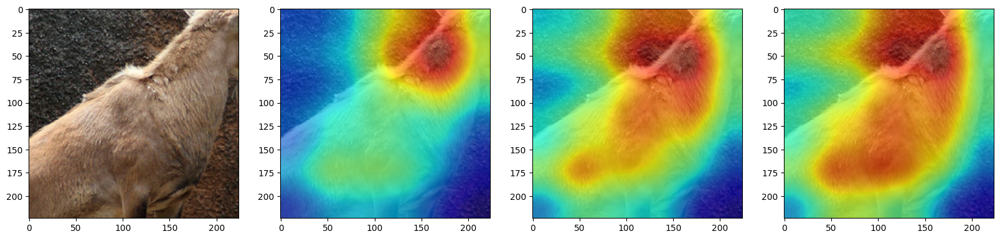

10 ----------------------------------------------------------------------------------------------------
class :  sorrel | score :  16.366201 | probability :  0.9979479
class :  ox | score :  8.679045 | probability :  0.00045773922
class :  basenji | score :  8.593678 | probability :  0.00042028516


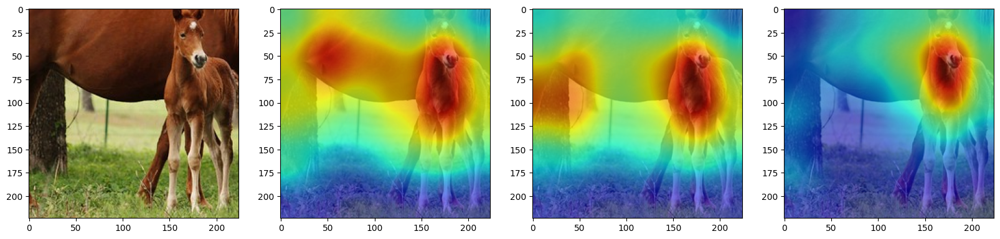

11 ----------------------------------------------------------------------------------------------------
class :  red wolf, maned wolf, Canis rufus, Canis niger | score :  16.088785 | probability :  0.5465351
class :  kit fox, Vulpes macrotis | score :  15.048848 | probability :  0.19318755
class :  red fox, Vulpes vulpes | score :  14.798764 | probability :  0.15044197


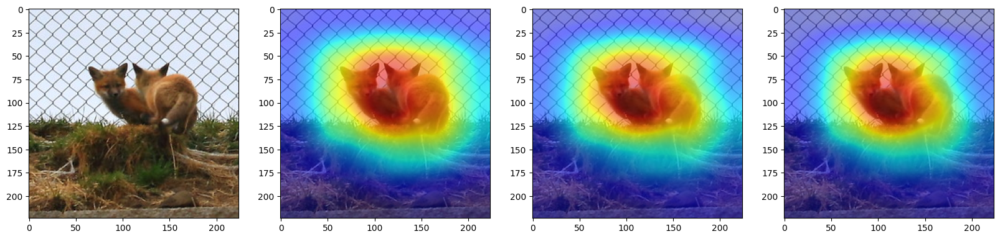

12 ----------------------------------------------------------------------------------------------------
class :  European gallinule, Porphyrio porphyrio | score :  10.860725 | probability :  0.46691033
class :  mink | score :  9.421441 | probability :  0.110703215
class :  scorpion | score :  9.061793 | probability :  0.07726223


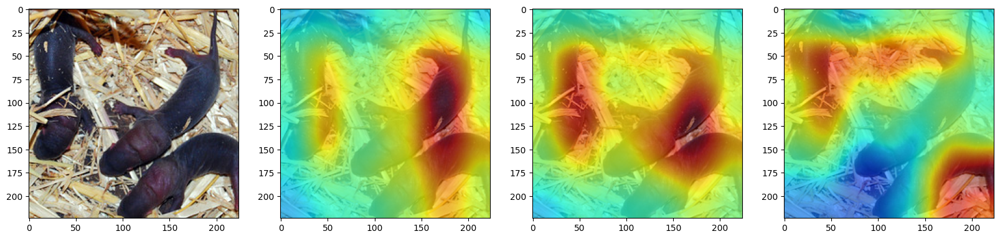

13 ----------------------------------------------------------------------------------------------------
class :  impala, Aepyceros melampus | score :  10.978717 | probability :  0.5438819
class :  gazelle | score :  10.05547 | probability :  0.2160448
class :  wallaby, brush kangaroo | score :  8.335083 | probability :  0.038671322


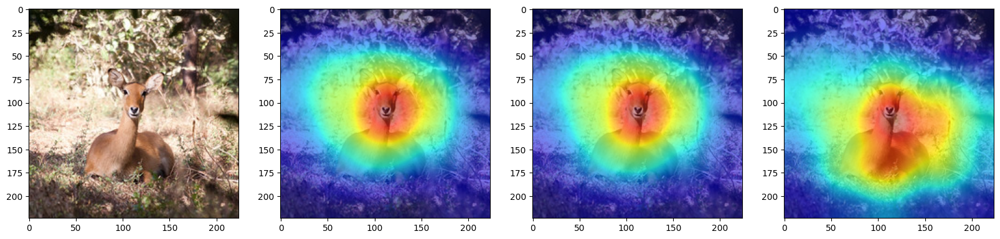

14 ----------------------------------------------------------------------------------------------------
class :  cougar, puma, catamount, mountain lion, painter, panther, Felis concolor | score :  19.1775 | probability :  0.9431534
class :  lion, king of beasts, Panthera leo | score :  16.290873 | probability :  0.05259398
class :  lynx, catamount | score :  13.312031 | probability :  0.0026744932


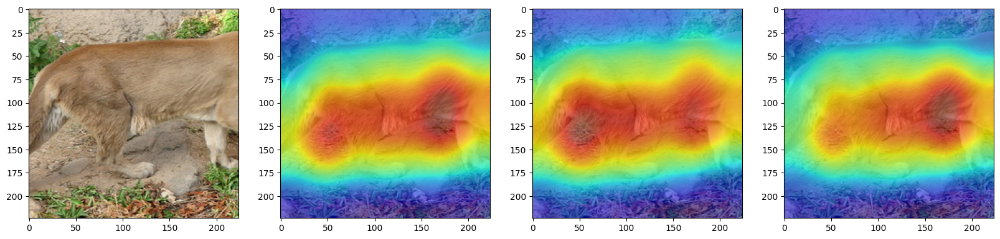

15 ----------------------------------------------------------------------------------------------------
class :  sea lion | score :  13.858747 | probability :  0.92526215
class :  cowboy boot | score :  10.653023 | probability :  0.037500463
class :  balance beam, beam | score :  9.035583 | probability :  0.0074403146


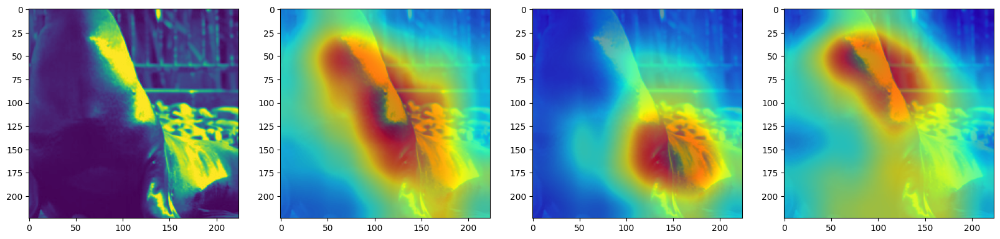

16 ----------------------------------------------------------------------------------------------------
class :  titi, titi monkey | score :  14.204726 | probability :  0.2947993
class :  howler monkey, howler | score :  14.015409 | probability :  0.2439536
class :  gibbon, Hylobates lar | score :  13.843261 | probability :  0.20537332


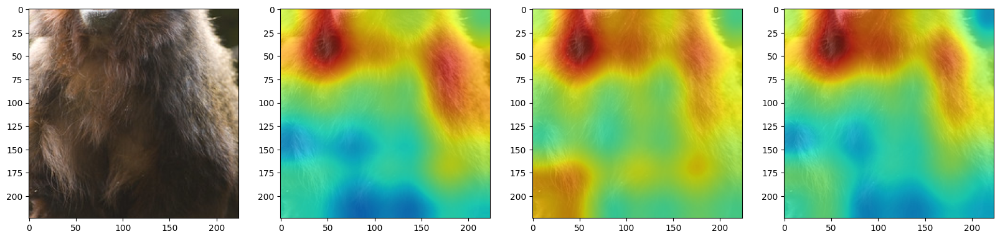

17 ----------------------------------------------------------------------------------------------------
class :  lesser panda, red panda, panda, bear cat, cat bear, Ailurus fulgens | score :  20.14974 | probability :  0.99731547
class :  polecat, fitch, foulmart, foumart, Mustela putorius | score :  13.586205 | probability :  0.0014071008
class :  weasel | score :  12.136655 | probability :  0.0003302127


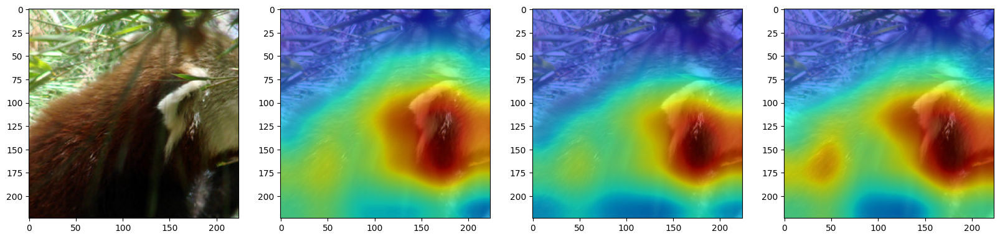

18 ----------------------------------------------------------------------------------------------------
class :  marmoset | score :  14.448006 | probability :  0.7287753
class :  three-toed sloth, ai, Bradypus tridactylus | score :  13.01179 | probability :  0.17332183
class :  fox squirrel, eastern fox squirrel, Sciurus niger | score :  10.905616 | probability :  0.021093724


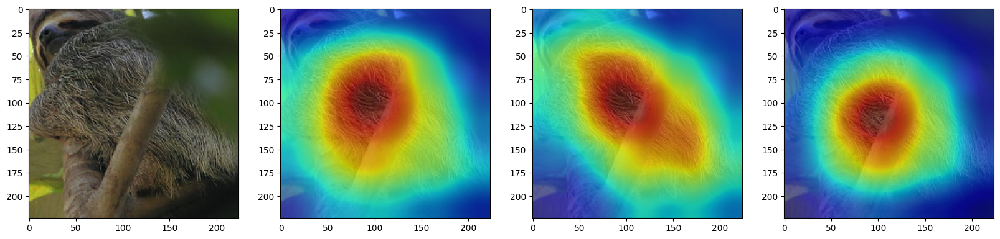

19 ----------------------------------------------------------------------------------------------------
class :  squirrel monkey, Saimiri sciureus | score :  19.487461 | probability :  0.52284515
class :  titi, titi monkey | score :  19.216002 | probability :  0.39854714
class :  spider monkey, Ateles geoffroyi | score :  17.486498 | probability :  0.07069127


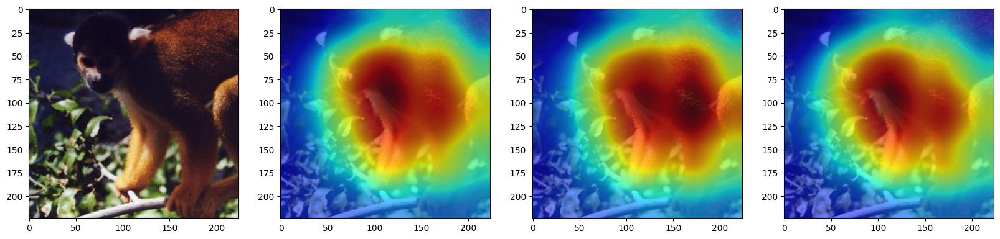

In [19]:
#Plot everything
for i in range(20):
    plot_masked(i)

#Discussion

GradCAM is a technique for providing interpretable explanations for predictions from CNN-based models. The goal is to find areas of the input which are relevant for the classification in order to obtain a visual explanation for model decisions.

For each image, we compare the heatmap of the three classes with the highest probabilities. We evaluate class discrimination by raising the following questions:

- Which part of the image contributes to the prediction ? Is it relevant for the decision of interest?
- How smooth are the boundaries ?
- How localized are important activations ?

When the target object is visually distinguishable (at the center, good lighting, no confusion with other objects), the trained model seems to concentrate on the same area of interest humans would do.



11 ----------------------------------------------------------------------------------------------------
class :  red wolf, maned wolf, Canis rufus, Canis niger | score :  16.088785 | probability :  0.5465351
class :  kit fox, Vulpes macrotis | score :  15.048848 | probability :  0.19318755
class :  red fox, Vulpes vulpes | score :  14.798764 | probability :  0.15044197


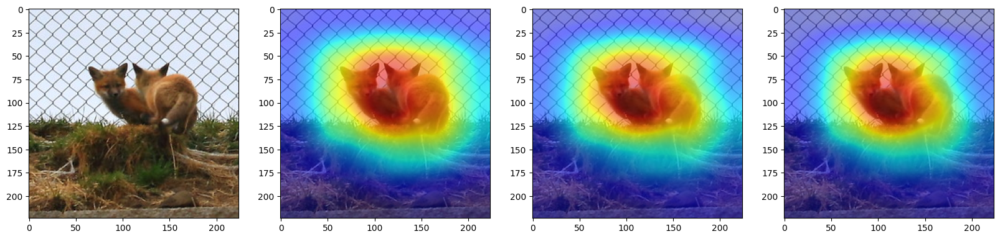

13 ----------------------------------------------------------------------------------------------------
class :  impala, Aepyceros melampus | score :  10.978717 | probability :  0.5438819
class :  gazelle | score :  10.05547 | probability :  0.2160448
class :  wallaby, brush kangaroo | score :  8.335083 | probability :  0.038671322


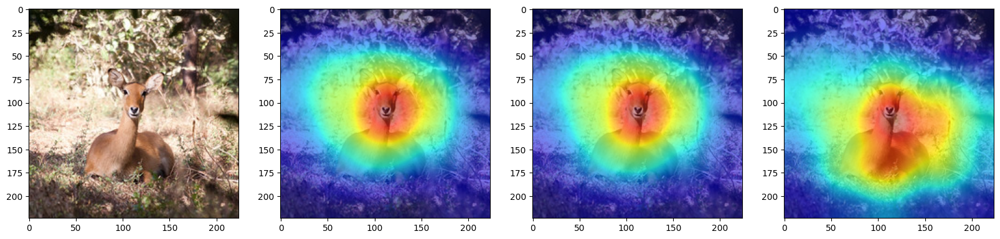

In [20]:
for i in [11,13]:
    plot_masked(i)

On the contrary in few images, probably due to a poor cropping, the network seems to focus on more anecdotic areas showing robustness.

0 ----------------------------------------------------------------------------------------------------
class :  African elephant, Loxodonta africana | score :  19.809284 | probability :  0.766189
class :  Indian elephant, Elephas maximus | score :  18.44351 | probability :  0.19551843
class :  tusker | score :  16.811417 | probability :  0.038227733


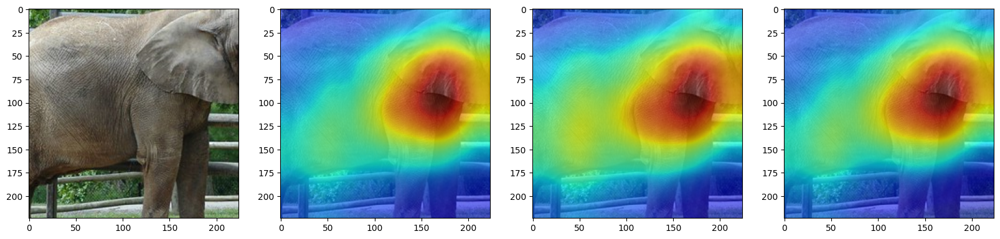

9 ----------------------------------------------------------------------------------------------------
class :  ibex, Capra ibex | score :  19.991968 | probability :  0.9961266
class :  bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis | score :  13.663734 | probability :  0.0017782694
class :  ram, tup | score :  13.241569 | probability :  0.0011658784


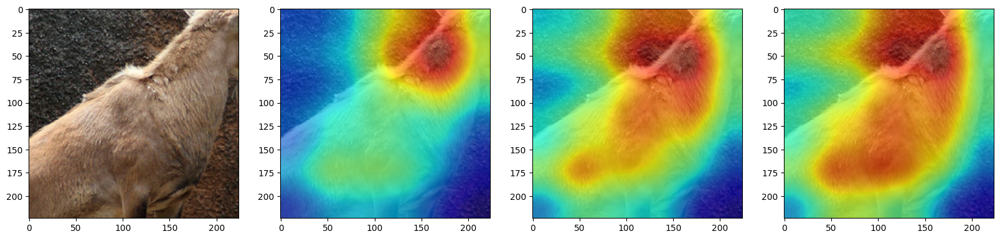

14 ----------------------------------------------------------------------------------------------------
class :  cougar, puma, catamount, mountain lion, painter, panther, Felis concolor | score :  19.1775 | probability :  0.9431534
class :  lion, king of beasts, Panthera leo | score :  16.290873 | probability :  0.05259398
class :  lynx, catamount | score :  13.312031 | probability :  0.0026744932


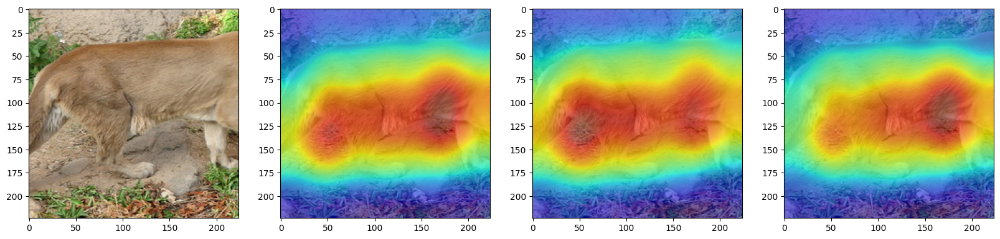

15 ----------------------------------------------------------------------------------------------------
class :  sea lion | score :  13.858747 | probability :  0.92526215
class :  cowboy boot | score :  10.653023 | probability :  0.037500463
class :  balance beam, beam | score :  9.035583 | probability :  0.0074403146


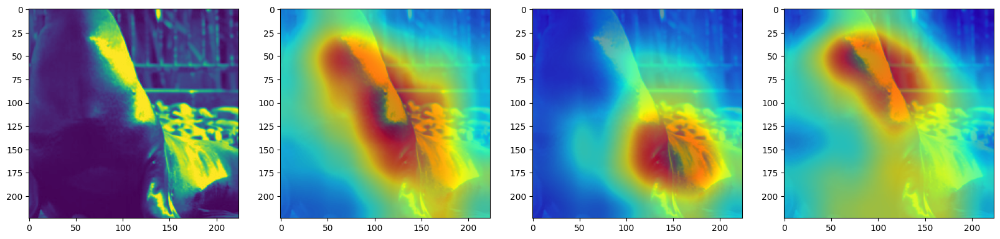

17 ----------------------------------------------------------------------------------------------------
class :  lesser panda, red panda, panda, bear cat, cat bear, Ailurus fulgens | score :  20.14974 | probability :  0.99731547
class :  polecat, fitch, foulmart, foumart, Mustela putorius | score :  13.586205 | probability :  0.0014071008
class :  weasel | score :  12.136655 | probability :  0.0003302127


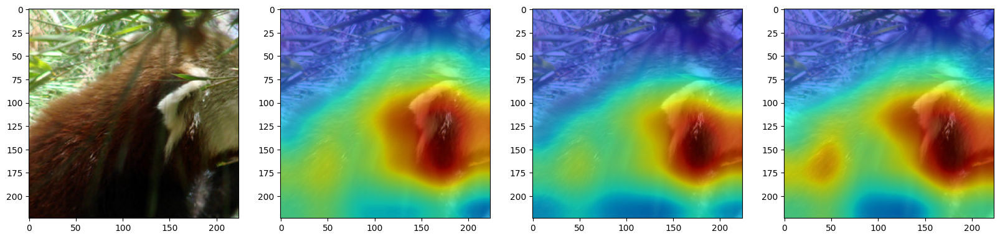

In [21]:
for i in [0,9,14,15,17]:
    plot_masked(i)

Interestingly for very few images, even if their is a clear spot where it should focus on to classify animals (usually the head), it seems to prefer wide textures. This could either come from a form of overfitting on the classes of the training set (only one class has this texture in the training set) - see 18 - or it could come from a large number of classes of the same animal (animal breeds such as Egyptian cat, tabby cat and tiger cat) - see 5 6 11.
In this last situation heatmaps are very close to each other as the classification is harder and often based on details in those characteristics.

18 ----------------------------------------------------------------------------------------------------
class :  marmoset | score :  14.448006 | probability :  0.7287753
class :  three-toed sloth, ai, Bradypus tridactylus | score :  13.01179 | probability :  0.17332183
class :  fox squirrel, eastern fox squirrel, Sciurus niger | score :  10.905616 | probability :  0.021093724


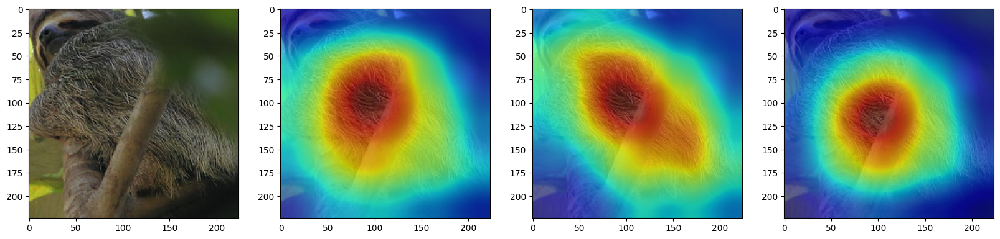

5 ----------------------------------------------------------------------------------------------------
class :  Egyptian cat | score :  13.175315 | probability :  0.82494885
class :  tabby, tabby cat | score :  11.065538 | probability :  0.10003748
class :  tiger cat | score :  10.584751 | probability :  0.061852813


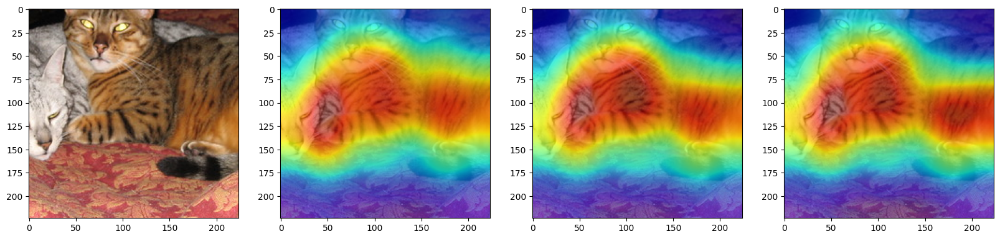

6 ----------------------------------------------------------------------------------------------------
class :  Arctic fox, white fox, Alopex lagopus | score :  13.450595 | probability :  0.6730168
class :  kit fox, Vulpes macrotis | score :  12.364035 | probability :  0.22705902
class :  grey fox, gray fox, Urocyon cinereoargenteus | score :  10.374113 | probability :  0.031040363


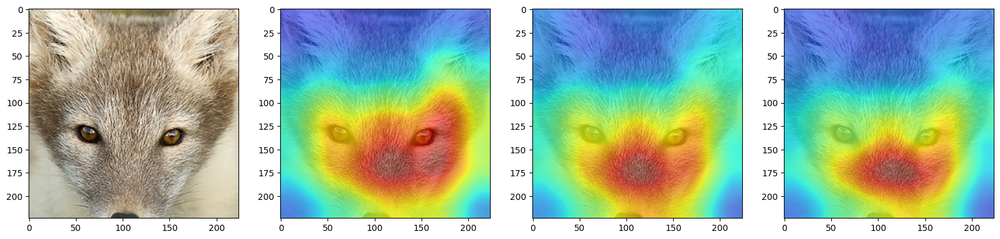

11 ----------------------------------------------------------------------------------------------------
class :  red wolf, maned wolf, Canis rufus, Canis niger | score :  16.088785 | probability :  0.5465351
class :  kit fox, Vulpes macrotis | score :  15.048848 | probability :  0.19318755
class :  red fox, Vulpes vulpes | score :  14.798764 | probability :  0.15044197


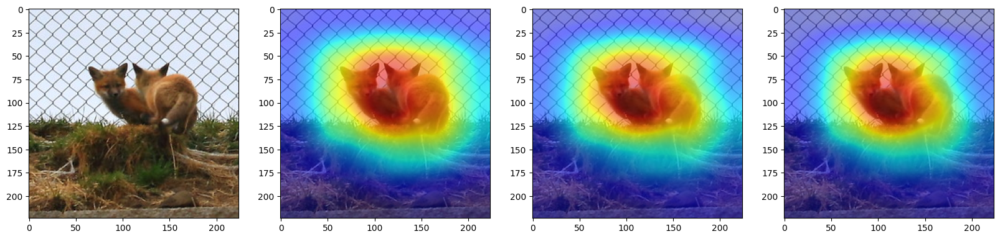

In [22]:
for i in [18,5,6,11]:
    plot_masked(i)

Nonetheless, the plotted heatmaps can be very different distributions when the entropy increases, i.e when there is a high uncertainty (new class the network hasn't been trained on, poorly cropped images, ...). The model tends to spatially extend the areas of interest, sometimes to non relevant objects (see image 12 3rd class).


3 ----------------------------------------------------------------------------------------------------
class :  Norwegian elkhound, elkhound | score :  12.780791 | probability :  0.4194778
class :  Cardigan, Cardigan Welsh corgi | score :  11.761657 | probability :  0.15139253
class :  German shepherd, German shepherd dog, German police dog, alsatian | score :  11.681355 | probability :  0.13971083


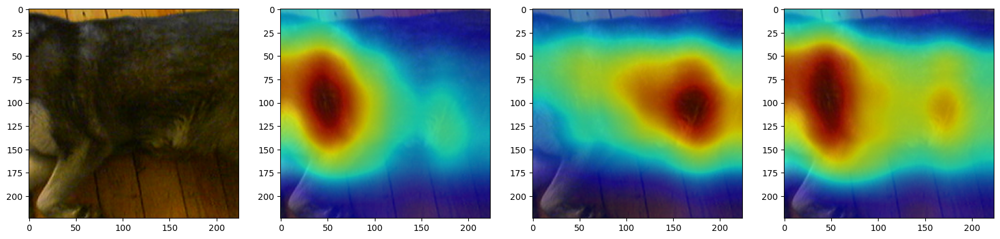

12 ----------------------------------------------------------------------------------------------------
class :  European gallinule, Porphyrio porphyrio | score :  10.860725 | probability :  0.46691033
class :  mink | score :  9.421441 | probability :  0.110703215
class :  scorpion | score :  9.061793 | probability :  0.07726223


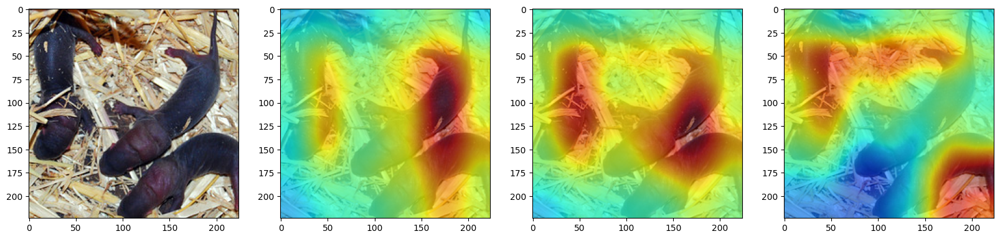

In [23]:
for i in [3,12]:
    plot_masked(i)

We can conclude that this tools works well to describe where the network focuses on when taking a decision. It can also be used to evaluate the robustness of the network as well as how this robustness works. In addition it is possible to use it on very specific images to evaluate limits of the network in terms of generalization (focuses on textures rather than interest points, ...). Lastly it shows where the network focuses on when taking a decision meaning that if this region is large the network is particularly vulnerable to adversarial attacks. Indeed an attacker could easily use such a large region to trick the network into not predicting this class without being noticed.